In [93]:
%pylab inline

Populating the interactive namespace from numpy and matplotlib


/srv/hdd1/Projects/env3/lib/python3.5/site-packages/IPython/core/magics/pylab.py:160: UserWarning:

pylab import has clobbered these variables: ['plot', 'test']
`%matplotlib` prevents importing * from pylab and numpy



In [94]:
import concurrent.futures
import pandas as pd
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
from sklearn.externals.joblib import Parallel, delayed
from sklearn import model_selection, metrics
from sklearn.neighbors import KDTree

init_notebook_mode(connected=True)
train = pd.read_csv('../input/training.txt', header=None, names=['id', 'type'])
test = pd.read_csv('../input/testing.txt', header=None, names=['id'])
type_to_idx = {t: i for i, t in enumerate(['trawler', 'longliner', 'seiner', 'other', 'support'])}
train.type = train.type.transform(lambda x: type_to_idx[x])

kfold = model_selection.StratifiedKFold(4, shuffle=True, random_state=123)
folds = []
for train_idxs, test_idxs in kfold.split(train, train.type):
    folds.append((train.iloc[train_idxs], train.iloc[test_idxs]))

def read_track(idx):
    return pd.read_csv('../input/VesselTracks/{}.csv'.format(idx))
    
train.head(5)

,id,type
0,100047,0
1,100070,1
2,100080,2
3,100093,3
4,100144,0


In [95]:
def get_deltas(part):
    R = 6371e3
    part = part.sort_values('Time(seconds)')
    first, second = part[:-1], part[1:]
    result = pd.DataFrame()
    result['d_t'] = second['Time(seconds)'].values - first['Time(seconds)'].values
    phi_1, phi_2 = np.radians(first['Latitude'].values), np.radians(second['Latitude'].values)
    d_phi = phi_2 - phi_1
    d_lambda = np.radians(second['Longitude'].values - first['Longitude'].values)
    a = np.sin(d_phi / 2) ** 2 + np.cos(phi_1) * np.cos(phi_2) * np.sin(d_lambda / 2) ** 2
    c = 2 * np.arctan2(np.sqrt(a), np.sqrt(1 - a))
    result['d_L'] = c * R
    result['speed'] = result['d_L'] / result['d_t']
    return result

part_deltas = get_deltas(part)

In [96]:
part_deltas.head(10)

,d_t,d_L,speed
0,951,0.977904,0.001028
1,969,1.407712,0.001453
2,951,1.968684,0.002070
3,959,1.905658,0.001987
4,729,2.054379,0.002818
5,231,0.654523,0.002833
6,961,1.715284,0.001785
7,958,0.370360,0.000387
8,961,0.333585,0.000347
9,960,0.241344,0.000251


In [97]:
%%time
all_deltas = pd.concat([get_deltas(read_track(idx)) for idx in train.id])

CPU times: user 9.35 s, sys: 124 ms, total: 9.47 s
Wall time: 9.64 s


In [100]:
pp = [0,1,5,10,20,30,40,50,60,70,80,90,95,99,100]
speed_bins = np.percentile(all_deltas['speed'], pp)
speed_bins

array([  0.00000000e+00,   0.00000000e+00,   0.00000000e+00,
         0.00000000e+00,   2.06001643e-03,   5.90728896e-03,
         1.87525583e-02,   1.56496151e-01,   1.08085267e+00,
         2.05829826e+00,   4.08043981e+00,   5.65426157e+00,
         6.88369766e+00,   9.07828686e+00,   1.35635645e+07])

In [114]:
np.percentile(part_deltas['speed'], pp)

array([  0.00000000e+00,   0.00000000e+00,   2.78531276e-04,
         4.38613249e-04,   6.71935035e-04,   8.79509093e-04,
         1.11182002e-03,   1.34522787e-03,   1.71061035e-03,
         2.40976206e-03,   9.39357987e-03,   2.53720707e+00,
         5.09823597e+00,   5.39986159e+00,   6.00675924e+00])

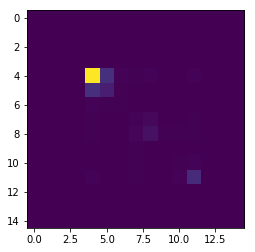

In [116]:
dd = np.digitize(part_deltas['speed'], speed_bins)
flat_coords = np.ravel_multi_index((dd[:-1], dd[1:]), (len(pp), len(pp)))
bc = np.bincount(flat_coords, minlength=len(pp)*len(pp)).reshape((len(pp), len(pp)))
imshow(bc)

In [118]:
percentiles = [0,1,5,10,20,30,40,50,60,70,80,90,95,99,100]

speed_bins = np.array([
        0.00000000e+00,   2.06001643e-03,   5.90728896e-03,
        1.87525583e-02,   1.56496151e-01,   1.08085267e+00,
        2.05829826e+00,   4.08043981e+00,   5.65426157e+00,
        6.88369766e+00,   9.07828686e+00,   1.35635645e+07])

def get_speed_stats(deltas):
    dd = np.digitize(deltas['speed'], speed_bins)
    s = speed_bins.shape[0]
    flat_coords = np.ravel_multi_index((dd[:-1], dd[1:]), (s, s))
    return np.bincount(flat_coords, minlength=s*s).reshape((s, s))

In [ ]:
imshow(get_speed_stats())

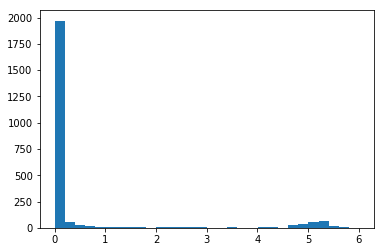

In [37]:
plt.hist(part_deltas.speed, bins=30);

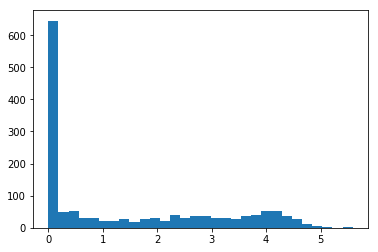

In [38]:
plt.hist(get_deltas(read_track('100216')).speed, bins=30);

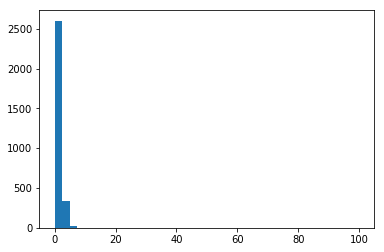

In [53]:
plt.hist(get_deltas(read_track('100161')).speed, bins=40, range=[0, 100]);

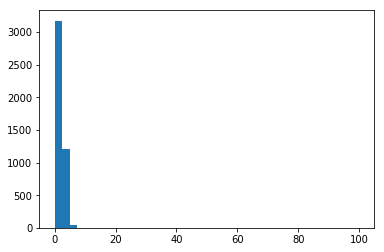

In [57]:
plt.hist(get_deltas(read_track('100175')).speed, bins=40, range=[0, 100]);

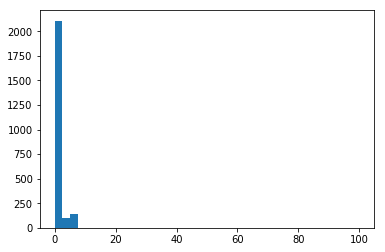

In [60]:
plt.hist(get_deltas(read_track('100204')).speed, bins=40, range=[0, 20]);

In [21]:
def calc_distances(idx, columns, group_columns, h_percentiles, v_percentiles):
    idx = str(idx)
    data = pd.read_csv('../input/TrackDistances/{}.csv'.format(idx), engine='c')
    parts = []
    for key in range(5):
        columns = group_columns[key]
        if idx in columns:
            columns = list(columns)
            columns.remove(idx)
        col_data = data[columns]
        h_data = np.percentile(col_data.values, h_percentiles, axis=1)
        result = np.percentile(h_data, v_percentiles, axis=1)
        parts.append(result.ravel())
#     print('DONE', idx)
    return np.hstack(parts)

def get_part_distances(part, columns, group_columns, percentiles, n_jobs=-1):
    parts = Parallel(n_jobs=n_jobs,
#                      backend="threading"
                    )(
        delayed(calc_distances)(idx, columns, group_columns, percentiles, percentiles)
        for idx in part.id)
    return np.vstack(parts)

def get_distance_features(train, test, percentiles):
    groups = {}
    group_columns = {}
    for key, group in train.groupby('type'):
        columns = [str(i) for i in group.id]
        group_columns[key] = columns
    train_features = get_part_distances(train, columns, group_columns, percentiles)
    test_features = get_part_distances(test, columns, group_columns, percentiles)
    return train_features, test_features


In [22]:
%%time
f = folds[0]
train_f, test_f = get_distance_features(f[0], f[1], list(range(0, 101, 10)))

CPU times: user 3.69 s, sys: 1.27 s, total: 4.96 s
Wall time: 1h 11min 40s


In [29]:
for i in folds:
    print(i[0].shape, i[1].shape)

(904, 2) (305, 2)
(907, 2) (302, 2)
(908, 2) (301, 2)
(908, 2) (301, 2)


In [30]:
train.shape

(1209, 2)

In [26]:
test_f.shape

(305, 605)

In [24]:
train_f.shape

(904, 605)

In [33]:
np.save('../input/fold_0_distances_train.npy', train_f)
np.save('../input/fold_0_distances_test.npy', test_f)

In [34]:
percentiles = list(range(0, 101, 10))
for idx, fold in enumerate(folds):
    if idx == 0: continue
    fold_train, fold_test = get_distance_features(fold[0], fold[1], percentiles)
    np.save('../input/fold_{}_distances_train.npy'.format(idx), fold_train)
    np.save('../input/fold_{}_distances_test.npy'.format(idx), fold_test)
    print('DONE', idx)

full_train, full_test = get_distance_features(train, test, percentiles)
np.save('../input/full_distances_train.npy', full_train)
np.save('../input/full_distances_test.npy', full_test)

DONE 1
DONE 2
DONE 3


AttributeError: 'function' object has no attribute 'id'

In [40]:
full_train, full_test = get_distance_features(train, test, percentiles)
np.save('../input/full_distances_train.npy', full_train)
np.save('../input/full_distances_test.npy', full_test)

In [35]:
train

,id,type
0,100047,0
1,100070,1
2,100080,2
3,100093,3
4,100144,0
5,100161,1
6,100175,0
7,100204,0
8,100216,3
9,100262,0


- Add speed
- Add max step length
- Remove invalid points

In [13]:
colors = ['red', 'blue', 'black', 'green', 'orange']

data = []

for _, i, c in train.head(70).itertuples():
    color = colors[np.where(train.type.unique() == c)[0][0]]
    df = pd.read_csv('../input/VesselTracks/{}.csv'.format(i))
#     df = df[(df.SOG >= 0) & (df.Salinity >= 0)]
    df = df[~np.sum(df == -99999, axis=1).astype(bool)]
    data.append(dict(
        lat = df['Latitude'],
        lon = df['Longitude'],
        marker = dict(
            color=color,
            reversescale = True,
            opacity = 0.7,
            size = 2,
            colorbar = dict(
                thickness = 10,
                titleside = "right",
                outlinecolor = "rgba(68, 68, 68, 0)",
                ticks = "outside",
                ticklen = 3,
                showticksuffix = "last",
                dtick = 0.1
            ),
        ),
        mode = 'lines',
        line = dict(
            width = 1,
            color = color,
        ),
        type = 'scattergeo',
        opacity = 0.75,
        name='{} {}'.format(i, c),
    ))

layout = dict(
    geo = dict(
        scope = 'world',
        showland = True,
        landcolor = "rgb(212, 212, 212)",
        subunitcolor = "rgb(255, 255, 255)",
        countrycolor = "rgb(255, 255, 255)",
        showlakes = True,
        lakecolor = "rgb(255, 255, 255)",
        showsubunits = True,
        showcountries = True,
        resolution = 100,
        projection = dict(
            scale = 1,
        ),
        
        lonaxis = dict(
            showgrid = True,
            gridwidth = 1,
            range= [ -70.0, 70.0 ],
            dtick = 5
        ),
        lataxis = dict (
            showgrid = True,
            gridwidth = 1,
            range= [ 2.0, 80.0 ],
            dtick = 5
        )
    ),
    title = 'All tracks',
)
fig = { 'data':data, 'layout':layout }
iplot(fig, filename='All tracks')

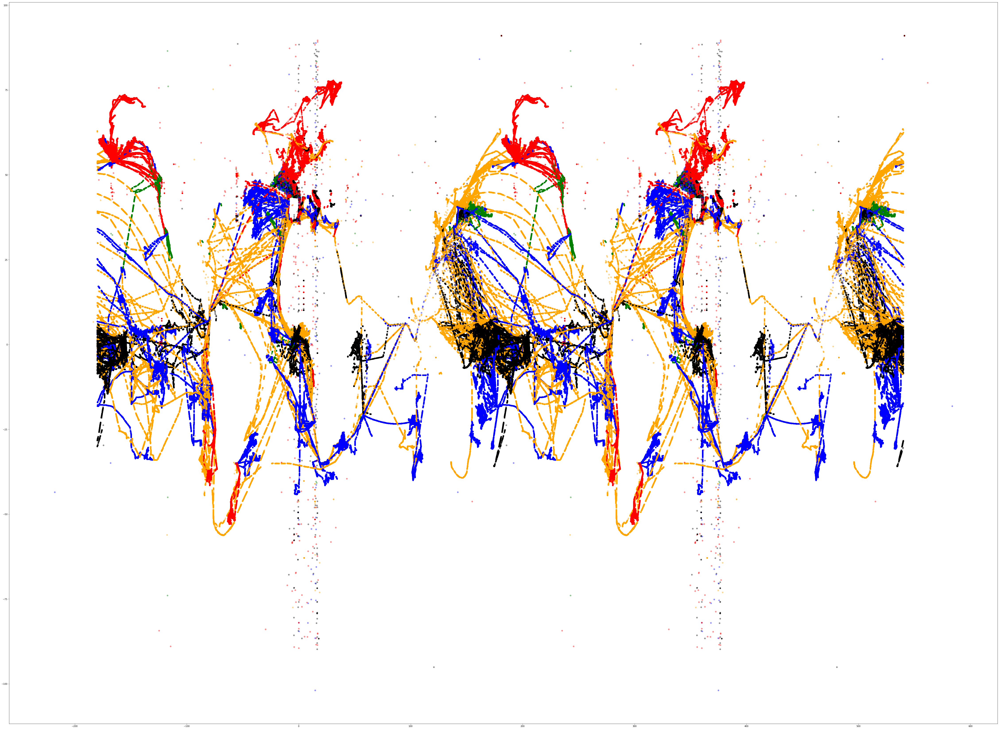

In [5]:
colors = ['red', 'blue', 'black', 'green', 'orange']

data = []

plt.figure(figsize=(80, 60))
for _, i, c in train.itertuples():
    color = colors[np.where(train.type.unique() == c)[0][0]]
    df = pd.read_csv('../input/VesselTracks/{}.csv'.format(i))
    scatter(df.Longitude, df.Latitude, c=color, alpha=0.4)
    scatter(df.Longitude+360, df.Latitude, c=color, alpha=0.4)

In [4]:
%%time

parts = [pd.read_csv('../input/VesselTracks/{}.csv'.format(i)) for i in train.id]
for p in parts:
    p.columns = ['TrackNumber', 'Time(seconds)', 'Latitude', 'Longitude', 'SOG',
       'Oceanic Depth', 'Chlorophyll Concentration', 'Salinity',
       'Water Surface Elevation', 'Sea Temperature', 'Thermocline Depth',
       'Eastward Water Velocity', 'Northward Water Velocity']
train_points = pd.concat(parts)
del parts
print(train_points.shape)

(8080623, 13)
CPU times: user 15.8 s, sys: 1.37 s, total: 17.2 s
Wall time: 36.1 s


In [7]:
%%time

kdtrees = {}
for idx in train.id:
    data = read_track(idx)
    data = data[['Latitude', 'Longitude']]
    data_mid = data
    data_left = data_mid[data_mid.Longitude >= 0].copy()
    data_left.Longitude -= 360
    data_right = data_mid[data_mid.Longitude < 0].copy()
    data_right.Longitude += 360
    data = pd.concat([data_left, data_mid, data_right])
    kdtrees[idx] = KDTree(data, leaf_size=100)

CPU times: user 32.9 s, sys: 648 ms, total: 33.6 s
Wall time: 50.4 s


In [10]:
import collections

kdtrees = collections.OrderedDict(kdtrees.items())

In [ ]:
def calc_distances(idx, kdtrees):
    data = read_track(idx)[['Latitude', 'Longitude']]
    columns = []
    for tree in kdtrees.values():
        distances, indices = query = tree.query(data, k=1)
        columns.append(distances)
    columns_np = np.hstack(columns)
    df = pd.DataFrame(columns_np, columns=kdtrees.keys())
    df['TrackNumber'] = idx
    df.to_csv('../input/TrackDistances/{}.csv'.format(idx, kdtrees), index=None)
    print('DONE', idx)
    

Parallel(n_jobs=-1)(delayed(calc_distances)(idx, kdtrees) for idx in train.id)

DONE 100070
DONE 100047
DONE 100216
DONE 100161
DONE 100204
DONE 100262
DONE 100175
DONE 100362
DONE 100093
DONE 100370
DONE 100277
DONE 100403
DONE 100383
DONE 100305
DONE 100080
DONE 100321
DONE 100448
DONE 100488
DONE 100380
DONE 100453
DONE 100494
DONE 100144
DONE 100528
DONE 100481
DONE 100595
DONE 100287
DONE 100599
DONE 100703
DONE 100813
DONE 100464
DONE 100457
DONE 100854
DONE 100625
DONE 100921
DONE 100963
DONE 100996
DONE 100580
DONE 100682
DONE 101096
DONE 101169
DONE 100539
DONE 100846
DONE 100821
DONE 101099
DONE 100639
DONE 101329
DONE 101223
DONE 101038
DONE 101206
DONE 101521
DONE 101588
DONE 101302
DONE 101718
DONE 101030
DONE 101717
DONE 101763
DONE 101794
DONE 101349
DONE 101764
DONE 101809
DONE 101173
DONE 101633
DONE 101743
DONE 101353
DONE 101928
DONE 101916
DONE 101965
DONE 102175
DONE 101808
DONE 101342
DONE 102062
DONE 102179
DONE 102215
DONE 102048
DONE 102164
DONE 102183
DONE 102260
DONE 102229
DONE 102177
DONE 102357
DONE 101975
DONE 102424
DONE 101947
DONE

In [ ]:
class KNN_model:
    def __init__(self, train, test, all_points):
        train_points = pd.merge(all_points, train, left_on='TrackNumber', right_on='id')
        train_points_mid = train_points[['Latitude', 'Longitude', 'id', 'type']]
        train_points_left = train_points_mid[train_points_mid.Longitude >= 0].copy()
        train_points_left.Longitude -= 360
        train_points_right = train_points_mid[train_points_mid.Longitude < 0].copy()
        train_points_right.Longitude += 360
        train_points = pd.concat([train_points_left, train_points_mid, train_points_right])
        self.train_points = train_points[['Latitude', 'Longitude']]
        self.train_ids = train_points.id
        self.train_data = train
        del train_points
        self.KDTree = KDTree(self.train_points, leaf_size=500)
        test_points = pd.merge(all_points, test, left_on='TrackNumber', right_on='id')
        self.test_points = test_points[['Latitude', 'Longitude']]
        self.test_ids = test_points.id
        del test_points

    def get_part(self, part, r):
        test_neighbour_classes = []
        part_indices = self.KDTree.query_radius(part, r, return_distance=False)
        for indices in part_indices:
#             print(indices.shape)
            ids = np.unique(self.train_ids.iloc[indices])
            classes = self.train_data.type[self.train_data.id.isin(ids)]
#             print(ids, ids.shape, classes.shape)
            test_neighbour_classes.append(np.bincount(classes, minlength=5))
        return np.array(test_neighbour_classes)
        
    def get_prediction(self, r, batch_size=20, n_jobs=1):
        test_values = self.test_points.values
        parts = Parallel(n_jobs=n_jobs)(
            delayed(self.get_part)(test_values[i:i+batch_size, :], r) for i in range(0, test_values.shape[0], batch_size))
        return np.vstack(parts)

f = folds[0]
m = KNN_model(f[0], f[1], train_points)
print('FINISHED BUILDING')

FINISHED BUILDING


In [ ]:
%%time
m.get_prediction(0.5, n_jobs=-1).shape

Process ForkPoolWorker-2:
Process ForkPoolWorker-1:
Process ForkPoolWorker-4:
Process ForkPoolWorker-5:
Process ForkPoolWorker-7:
Process ForkPoolWorker-6:
Traceback (most recent call last):
Traceback (most recent call last):
Traceback (most recent call last):
Traceback (most recent call last):
  File "/usr/lib/python3.5/multiprocessing/process.py", line 249, in _bootstrap
    self.run()
  File "/usr/lib/python3.5/multiprocessing/process.py", line 249, in _bootstrap
    self.run()
  File "/usr/lib/python3.5/multiprocessing/process.py", line 249, in _bootstrap
    self.run()
Traceback (most recent call last):
  File "/usr/lib/python3.5/multiprocessing/process.py", line 249, in _bootstrap
    self.run()
  File "/usr/lib/python3.5/multiprocessing/process.py", line 93, in run
    self._target(*self._args, **self._kwargs)
  File "/usr/lib/python3.5/multiprocessing/process.py", line 93, in run
    self._target(*self._args, **self._kwargs)
  File "/usr/lib/python3.5/multiprocessing/process.py

In [ ]:
%%time
m.get_prediction(1, n_jobs=-1).shape

In [68]:
train_points[['Latitude', 'Longitude']].describe()

,Latitude,Longitude
count,8.080623e+06,8.080623e+06
mean,2.796734e+01,-2.567003e+01
std,2.914984e+01,1.090725e+02
min,-1.018757e+02,-2.179083e+02
25%,1.987981e+00,-1.246882e+02
50%,4.103076e+01,-5.097478e+00
75%,5.362523e+01,1.537687e+01
max,9.100000e+01,2.236537e+02


In [ ]:
train_points[train_points.]

In [73]:
full_train = pd.merge(train_points, train, left_on='TrackNumber', right_on='id')

In [74]:
full_train.head(10)

,TrackNumber,Time(seconds),Latitude,Longitude,SOG,Oceanic Depth,Chlorophyll Concentration,Salinity,Water Surface Elevation,Sea Temperature,Thermocline Depth,Eastward Water Velocity,Northward Water Velocity,id,type
0,100047,0,41.101078,1.235355,7.4,-4,0.3105,34.3,-0.22,10.7,111.0,0.06,0.01,100047,trawler
1,100047,931,41.074507,1.221120,5.1,-11,0.3043,34.3,-0.22,10.7,109.5,0.06,0.02,100047,trawler
2,100047,2221,41.043652,1.279553,10.2,-16,0.3059,34.3,-0.23,10.7,117.4,0.06,0.04,100047,trawler
3,100047,3872,40.998603,1.365502,10.5,-46,0.3674,34.3,-0.24,10.6,123.8,0.08,0.07,100047,trawler
4,100047,3873,40.998603,1.365502,10.5,-46,0.3674,34.3,-0.24,10.6,123.8,0.08,0.07,100047,trawler
5,100047,3877,40.998602,1.365502,10.5,-46,0.3674,34.3,-0.24,10.6,123.8,0.08,0.07,100047,trawler
6,100047,5292,40.964557,1.438760,3.1,-90,0.3405,34.3,-0.24,10.5,122.1,0.12,0.10,100047,trawler
7,100047,6231,40.944548,1.438893,2.4,-105,0.3413,34.3,-0.24,10.6,120.2,0.12,0.10,100047,trawler
8,100047,6896,40.936732,1.436485,3.1,-110,0.3422,34.3,-0.24,10.6,119.3,0.12,0.09,100047,trawler
9,100047,7571,40.928045,1.431135,3.1,-115,0.3435,34.3,-0.24,10.6,118.1,0.12,0.09,100047,trawler


In [65]:
train_points.head(4)

,TrackNumber,Time(seconds),Latitude,Longitude,SOG,Oceanic Depth,Chlorophyll Concentration,Salinity,Water Surface Elevation,Sea Temperature,Thermocline Depth,Eastward Water Velocity,Northward Water Velocity
0,100047,0,41.101078,1.235355,7.4,-4,0.3105,34.3,-0.22,10.7,111.0,0.06,0.01
1,100047,931,41.074507,1.221120,5.1,-11,0.3043,34.3,-0.22,10.7,109.5,0.06,0.02
2,100047,2221,41.043652,1.279553,10.2,-16,0.3059,34.3,-0.23,10.7,117.4,0.06,0.04
3,100047,3872,40.998603,1.365502,10.5,-46,0.3674,34.3,-0.24,10.6,123.8,0.08,0.07
